# Parte 1b: Análisis de preguntas

## Importacion de librerias
#### ********************************************************************************************

In [67]:
import pandas as pd
import folium
import geopandas as gpd
from folium.plugins import HeatMap
import matplotlib.pyplot as plt
import os
from IPython.display import display
import branca.colormap as cm
import seaborn as sns
import numpy as np

#### ********************************************************************************************
### Pregunta 1: ¿Cuál es la relación entre las paradas de autobús y la densidad de población en diferentes barrios? ¿influye el transporte publico?
#### ********************************************************************************************

In [2]:
#Datasets a utilizar
df_paradas = pd.read_csv('../new_datasets/new_bus_stops.csv')
df_poblacion = pd.read_csv('../new_datasets/new_population.csv')
df_transporte = pd.read_csv('../new_datasets/new_transports.csv')
df_renta = pd.read_csv('../auxiliares/2021_atles_renda_bruta_llar.csv')
df_divisiones = gpd.read_file('../auxiliares/0301100100_UNITATS_ADM_POLIGONS.json')

In [3]:
df_divisiones.head()

,FID,ID_ANNEX,ANNEXDESCR,ID_TEMA,TEMA_DESCR,ID_CONJUNT,CONJ_DESCR,ID_SUBCONJ,SCONJ_DESC,ID_ELEMENT,...,CODI_UA,TIPUS_UA,NOM,WEB1,WEB2,WEB3,FHEX_COLOR,Shape_Leng,Shape_Area,geometry
0,0,01,Grup - I,0104,Unitats Administratives,010411,Terme Municipal,01041101,Terme Municipal,0104110101,...,080193,TERME,Barcelona,http://www.bcn.cat,http://www.bcn.cat/estadistica/catala/dades/in...,http://www.bcn.cat/estadistica/catala/document...,#000000,114036.624503,1.017050e+08,"MULTIPOLYGON (((432115.848 4590999.098, 432010..."
1,1,01,Grup - I,0104,Unitats Administratives,010412,Districtes,01041201,Districte,0104120101,...,01,DISTRICTE,Ciutat Vella,http://www.bcn.cat/ciutatvella,http://www.bcn.cat/estadistica/catala/dades/gu...,http://www.bcn.cat/estadistica/catala/document...,#000000,21366.961806,4.204931e+06,"POLYGON ((431733.736 4582441.816, 431645.093 4..."
2,2,01,Grup - I,0104,Unitats Administratives,010412,Districtes,01041201,Districte,0104120101,...,02,DISTRICTE,Eixample,http://www.bcn.cat/eixample,http://www.bcn.cat/estadistica/catala/dades/gu...,http://www.bcn.cat/estadistica/catala/document...,#000000,13931.644175,7.464303e+06,"POLYGON ((432033.184 4583665.032, 432033.186 4..."
3,3,01,Grup - I,0104,Unitats Administratives,010412,Districtes,01041201,Districte,0104120101,...,03,DISTRICTE,Sants-Montjuïc,http://www.bcn.cat/sants-montjuic,http://www.bcn.cat/estadistica/catala/dades/gu...,http://www.bcn.cat/estadistica/catala/document...,#000000,46711.856798,2.287985e+07,"MULTIPOLYGON (((428773.911 4580873.742, 428692..."
4,4,01,Grup - I,0104,Unitats Administratives,010412,Districtes,01041201,Districte,0104120101,...,04,DISTRICTE,Les Corts,http://www.bcn.cat/lescorts,http://www.bcn.cat/estadistica/catala/dades/gu...,http://www.bcn.cat/estadistica/catala/document...,#000000,12551.602001,6.010769e+06,"POLYGON ((425054.67 4583672.56, 425047.22 4583..."


In [4]:
#Mapa de barcelona con las divisiones
m = folium.Map(location=[41.3851, 2.1734], zoom_start=12)
folium.GeoJson(
    df_divisiones,
    style_function=lambda feature: {
        'fillColor': 'lightblue',
        'color': 'black',
        'weight': 2,
        'fillOpacity': 0.7,
    }
).add_to(m)
m

In [5]:
df_paradas.head()

,Code,Transport,Longitude,Latitude,Bus.Stop,District.Name,Neighborhood.Name
0,K014,Day bus stop,2.171619,41.413744,BUS -192--,Horta-Guinardó,el Guinardó
1,K014,Day bus stop,2.134902,41.420222,BUS -124--,Gràcia,Vallcarca i els Penitents
2,K014,Day bus stop,2.162913,41.423187,BUS -117--,Horta-Guinardó,la Font d'en Fargues
3,K014,Day bus stop,2.163667,41.422899,BUS -117--,Horta-Guinardó,la Font d'en Fargues
4,K014,Day bus stop,2.120212,41.397209,BUS -130--,Sarrià-Sant Gervasi,Sarrià


In [6]:
df_poblacion.head()

,Year,District.Code,District.Name,Neighborhood.Code,Neighborhood.Name,Gender,Age,Number
0,2017,1,Ciutat Vella,1,el Raval,Male,0-4,224
1,2017,1,Ciutat Vella,2,el Barri Gòtic,Male,0-4,50
2,2017,1,Ciutat Vella,3,la Barceloneta,Male,0-4,43
3,2017,1,Ciutat Vella,4,"Sant Pere, Santa Caterina i la Ribera",Male,0-4,95
4,2017,2,Eixample,5,el Fort Pienc,Male,0-4,124


In [44]:
df_divisiones = df_divisiones.to_crs(epsg=4326)

# Crear el GeoDataFrame de paradas (asumiendo que ya está en EPSG:4326)
gdf_paradas = gpd.GeoDataFrame(
    df_paradas, 
    geometry=gpd.points_from_xy(df_paradas.Longitude, df_paradas.Latitude),
    crs="EPSG:4326"
)

# Realizar un spatial join para contar paradas por barrio
paradas_por_barrio = gpd.sjoin(gdf_paradas, df_divisiones, how="inner", predicate="within")
conteo_paradas = paradas_por_barrio.groupby('NOM').size().reset_index(name='conteo')

# Unir el conteo con los polígonos de los barrios
barrios_con_conteo = df_divisiones.merge(conteo_paradas, on='NOM', how='left')
barrios_con_conteo['conteo'] = barrios_con_conteo['conteo'].fillna(0)

# Calcular los centroides correctamente
barrios_con_conteo_proj = barrios_con_conteo.to_crs(epsg=3857)
centroids = barrios_con_conteo_proj.geometry.centroid
centroids = centroids.to_crs(epsg=4326)
barrios_con_conteo['centro_lat'] = centroids.y
barrios_con_conteo['centro_lon'] = centroids.x

# Crear el mapa
m = folium.Map(location=[41.3851, 2.1734], zoom_start=12)

# Añadir los polígonos de los barrios al mapa
folium.GeoJson(
    barrios_con_conteo,
    style_function=lambda feature: {
        'fillColor': 'lightblue',
        'color': 'black',
        'weight': 1,
        'fillOpacity': 0.1,  # Reducido para mayor transparencia
    },
    tooltip=folium.GeoJsonTooltip(fields=['NOM', 'conteo'], aliases=['Barrio', 'Número de paradas'])
).add_to(m)

# Crear datos para el mapa de calor
heat_data = [[row['centro_lat'], row['centro_lon'], row['conteo']] for idx, row in barrios_con_conteo.iterrows()]

# Añadir el mapa de calor con mayor transparencia
HeatMap(heat_data, radius=15, blur=10, max_zoom=1, gradient={0.4: 'blue', 0.65: 'lime', 1: 'red'}, overlay=True, opacity=0.6).add_to(m)

#Exportar el mapa de calor
m.save("./exports/mapa_calor_pregunta1.html")

# Mostrar el mapa
m

### Conclusiones

Podemos observar que la densidad de paradas de autobus en los barrios de Barcelona no es uniforme, existen barrios con mayor cantidad de paradas que otros. En el mapa podemos observar que los barrios del centro de la ciudad son los que tienen mayor cantidad de paradas de autobus, mientras que los barrios perifericos tienen menos paradas. Esto puede deberse a que los barrios del centro de la ciudad tienen mayor densidad de poblacion y por lo tanto mayor demanda de transporte publico.

#### ********************************************************************************************
### Pregunta 2: ¿Cuál es la nacionalidad más común entre los inmigrantes en Barcelona?
#### ********************************************************************************************

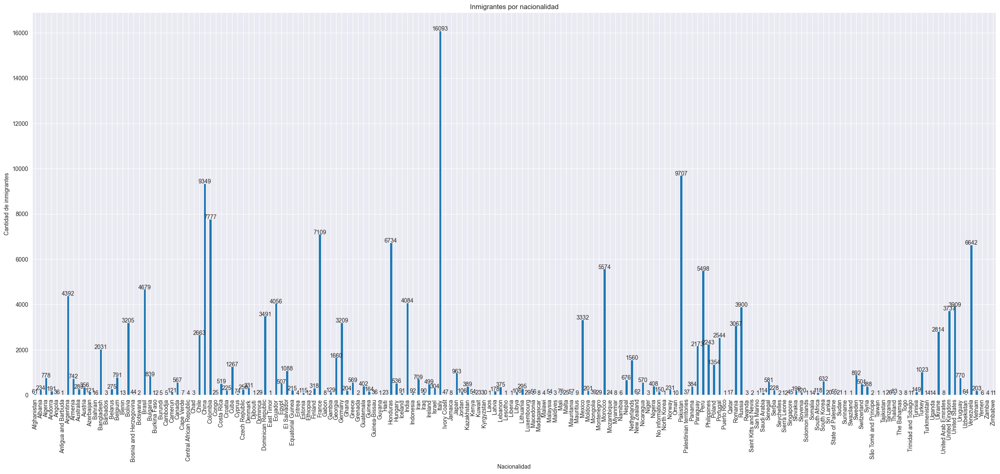

In [8]:
df_inmigrantes = pd.read_csv("../new_datasets/new_immigrants_nationality.csv")
    
# Graficar la cantidad de inmigrantes por nacionalidad

# eliminar de la tabla de Nationality todos los valores de Spain
df_inmigrantes = df_inmigrantes[df_inmigrantes['Nationality'] != 'Spain']

df_inmigrantes.groupby('Nationality')['Number'].sum().plot(kind='bar', figsize=(30,12))

plt.title('Inmigrantes por nacionalidad')
plt.xlabel('Nacionalidad')
plt.ylabel('Cantidad de inmigrantes')

# Agregarle el valor a cada barra
for index, value in enumerate(df_inmigrantes.groupby('Nationality')['Number'].sum()):
    plt.text(index, value, str(value), ha='center')

# plotear
plt.show()

### Conclusiones

Podemos reconocer facilmente a Italia como la nacionalidad mas comun entre los inmigrantes en Barcelona, seguido por Pakistan y China.

#### ********************************************************************************************
### Pregunta 3: ¿Cómo varía la cantidad de nacimientos por género con el tiempo en diferentes distritos y barrios de Barcelona?
#### ********************************************************************************************

In [9]:
df_nacimientos = pd.read_csv('../new_datasets/new_births.csv')
df_nacimientos.head()

,Year,District Code,District Name,Neighborhood Code,Neighborhood Name,Gender,Number
0,2017,1,Ciutat Vella,1,el Raval,Boys,283
1,2017,1,Ciutat Vella,2,el Barri Gòtic,Boys,56
2,2017,1,Ciutat Vella,3,la Barceloneta,Boys,51
3,2017,1,Ciutat Vella,4,"Sant Pere, Santa Caterina i la Ribera",Boys,90
4,2017,2,Eixample,5,el Fort Pienc,Boys,117


In [10]:
df_nacimientos.columns

Index(['Year', 'District Code', 'District Name', 'Neighborhood Code',
       'Neighborhood Name', 'Gender', 'Number'],
      dtype='object')

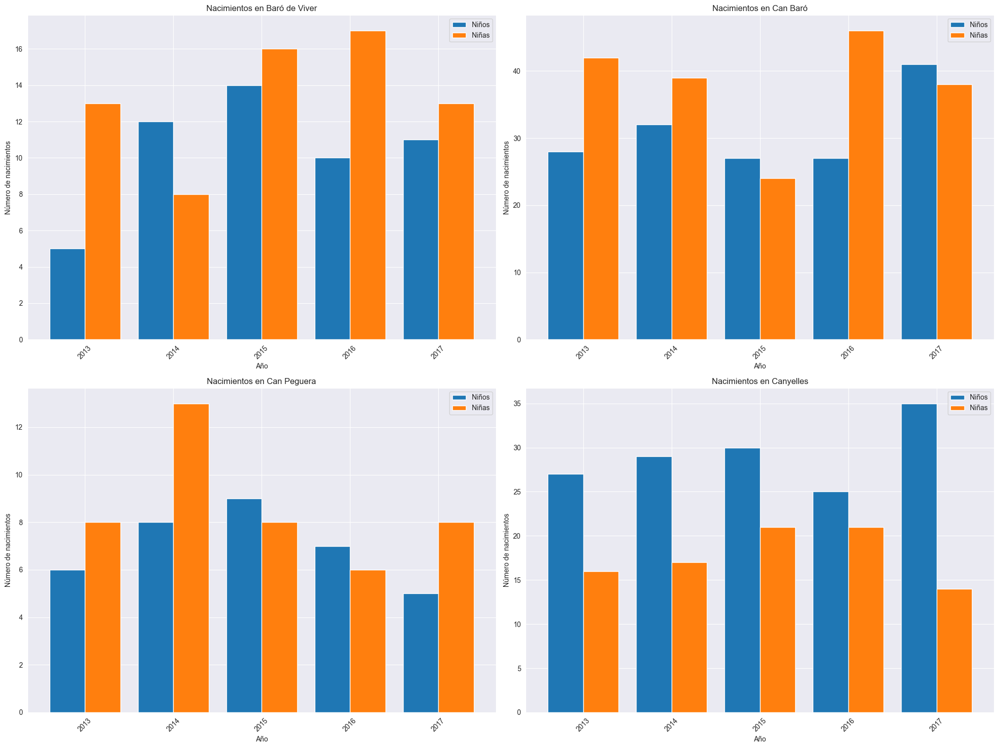

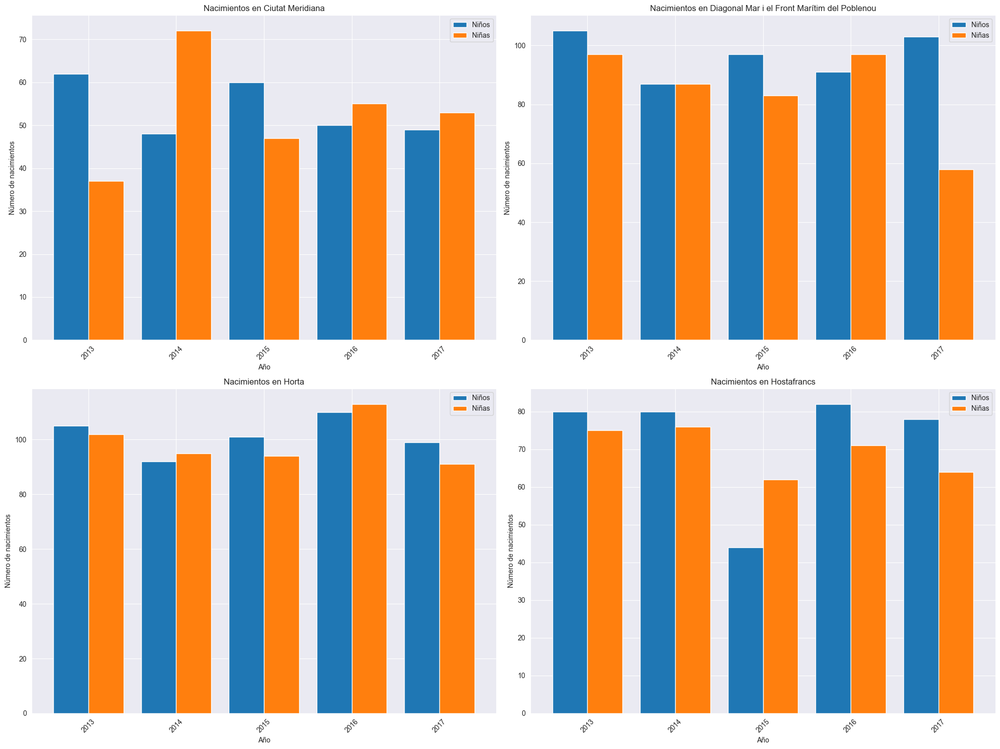

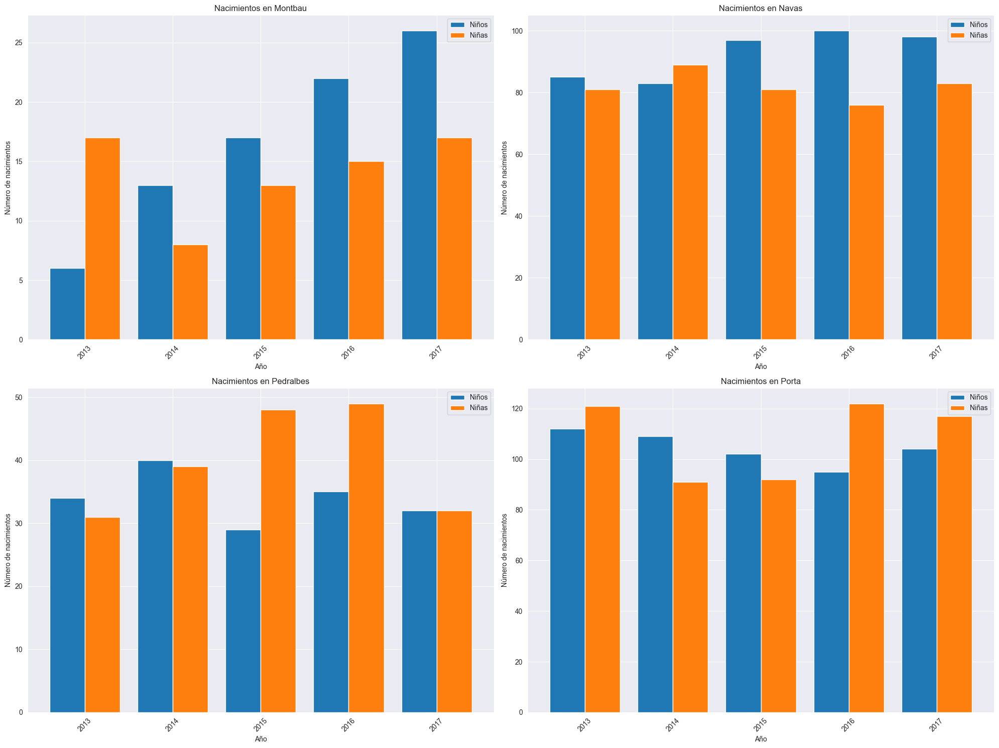

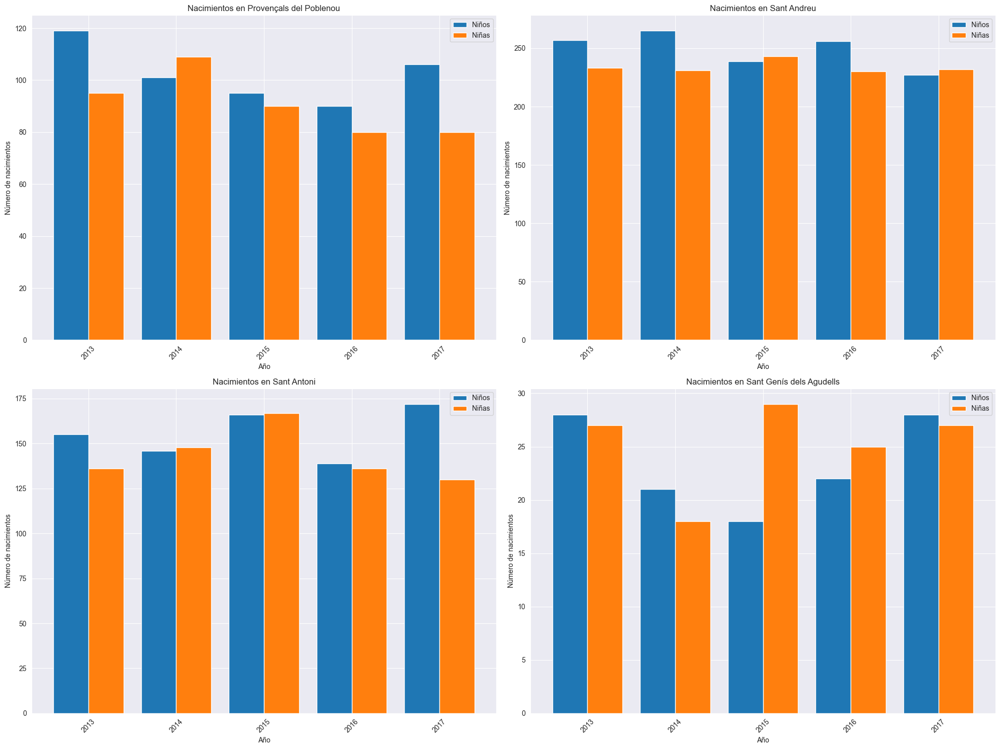

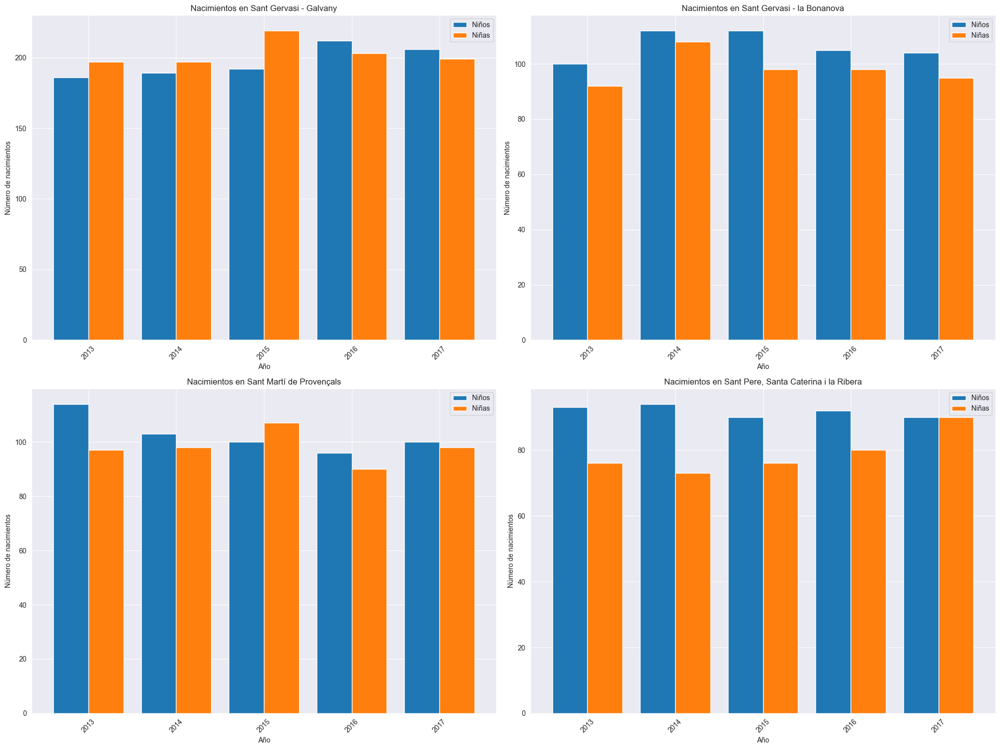

...

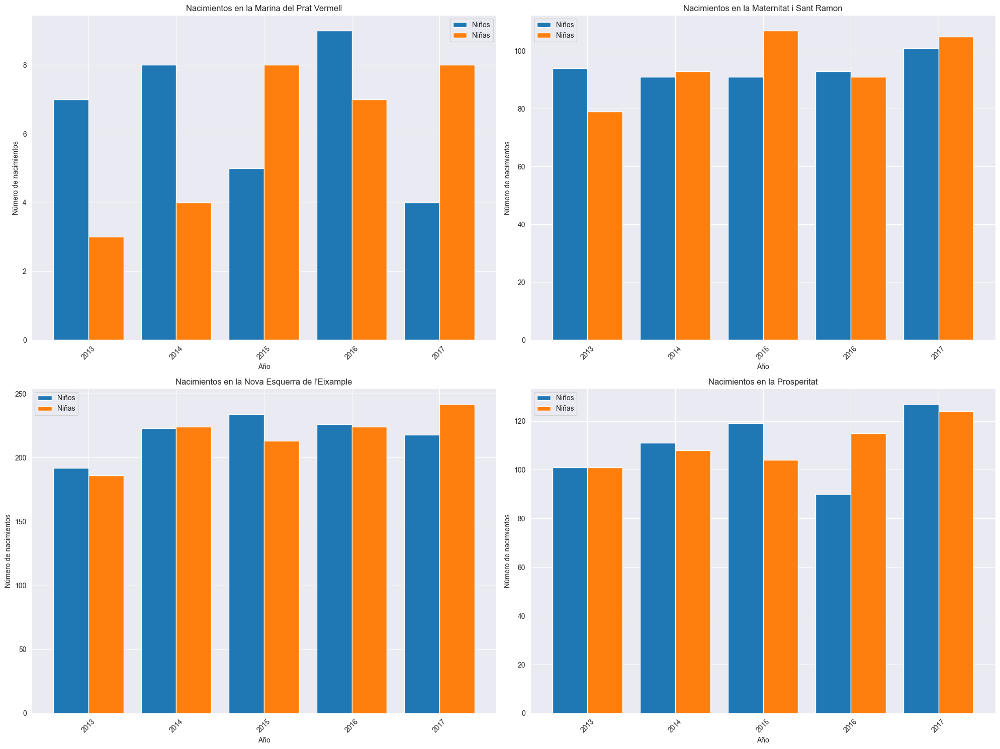

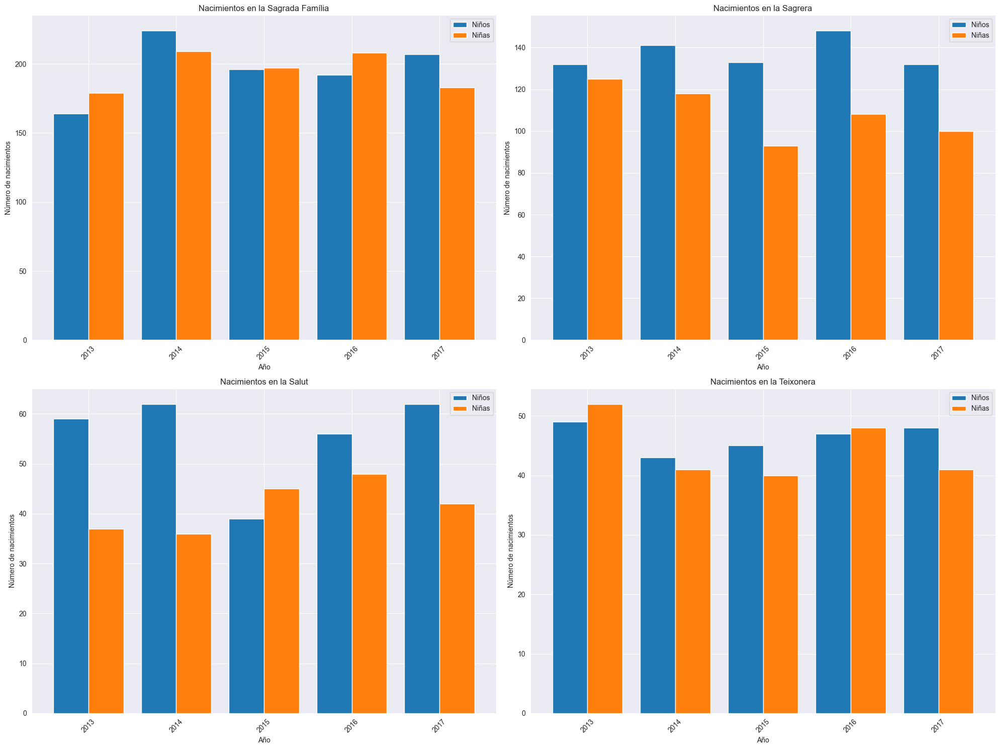

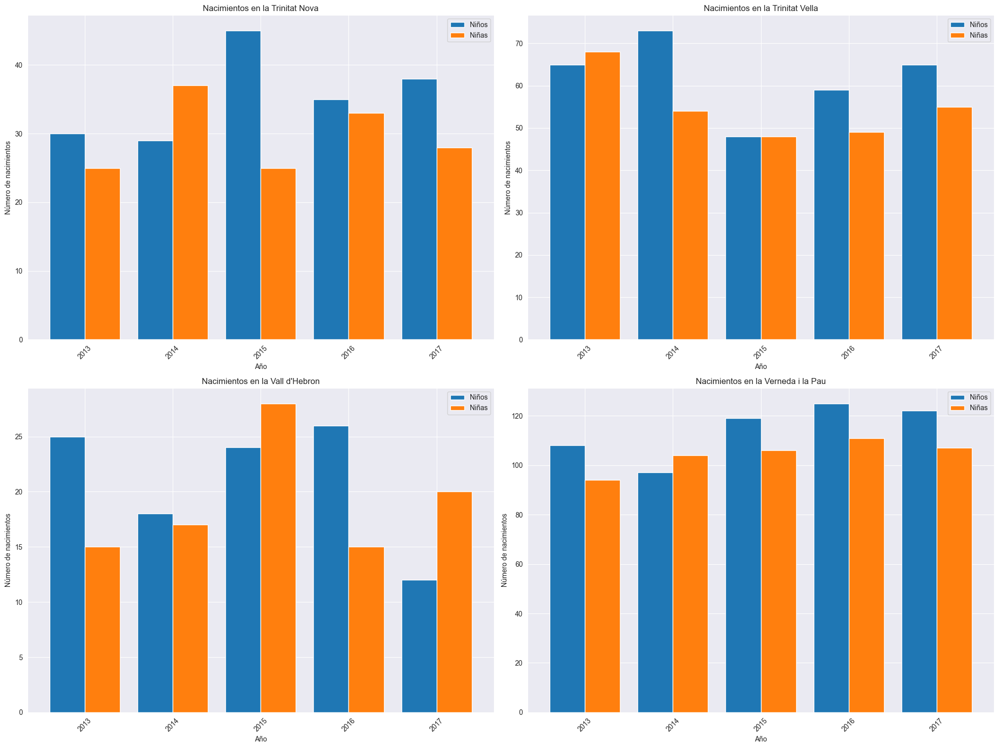

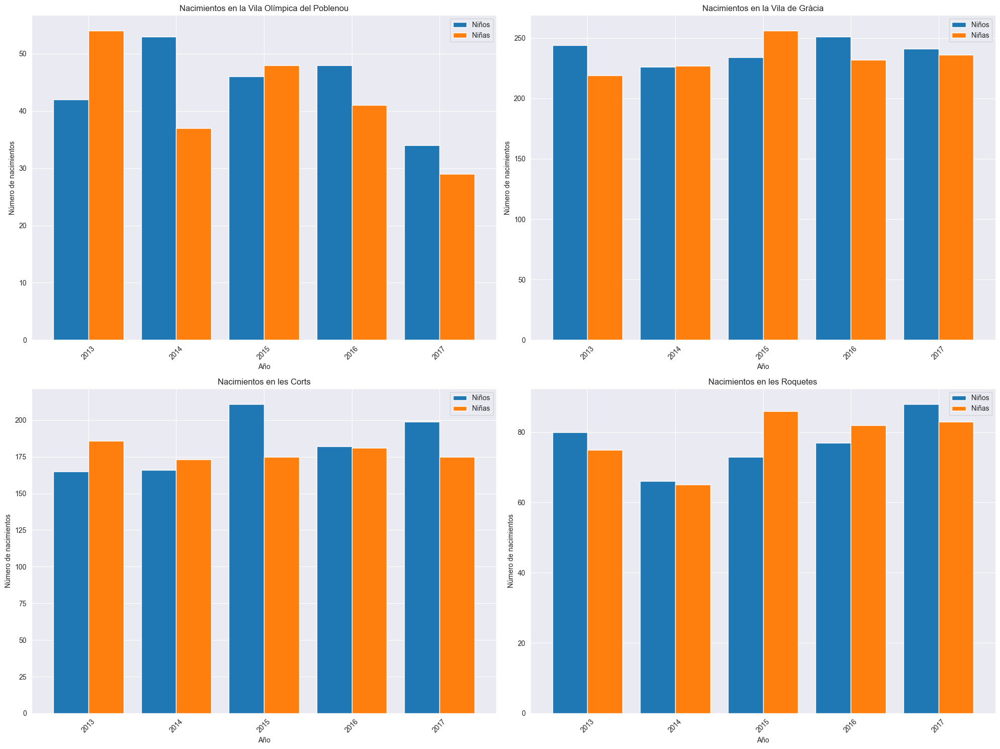

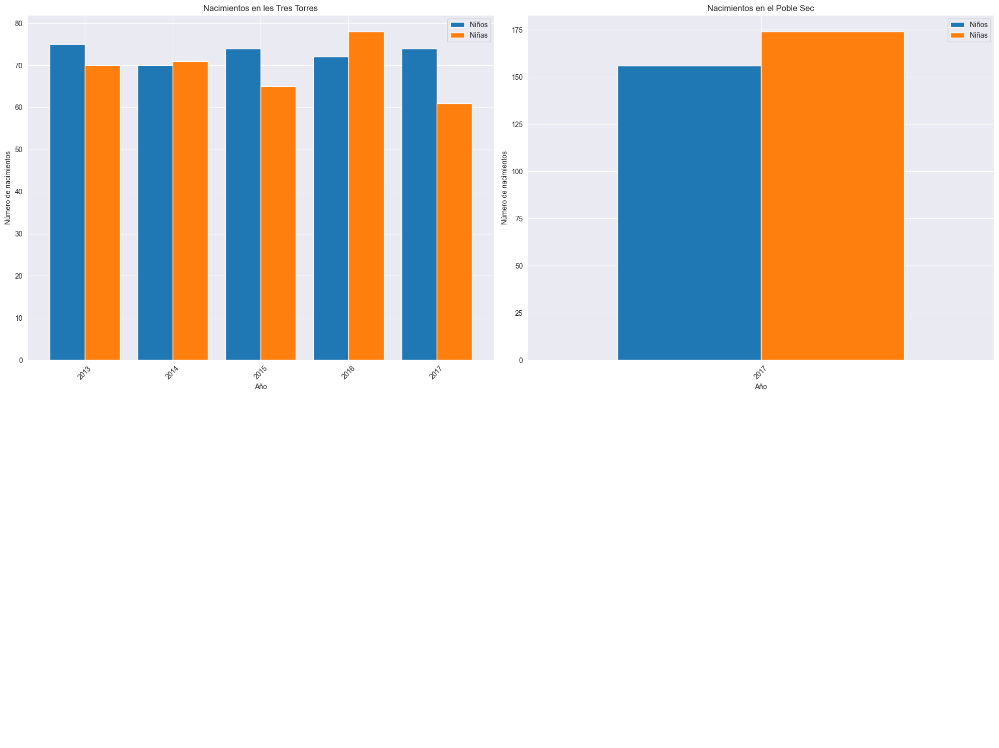

In [11]:
# Agrupar los datos por Año, Barrio y Género
df_grouped = df_nacimientos.groupby(['Year', 'Neighborhood Name', 'Gender'])['Number'].sum().unstack(level='Gender')

# Obtener la lista de barrios únicos que existen en df_grouped
neighborhoods = df_grouped.index.get_level_values('Neighborhood Name').unique()

# Función para crear un conjunto de gráficas
def plot_neighborhoods(neighborhoods, start_idx, num_plots):
    fig, axes = plt.subplots(2, 2, figsize=(20, 15))
    axes = axes.ravel()  # Aplanar el array de ejes para facilitar la iteración
    
    for i in range(4):
        ax = axes[i]
        if start_idx + i < len(neighborhoods):
            neighborhood = neighborhoods[start_idx + i]
            data = df_grouped.xs(neighborhood, level='Neighborhood Name')
            
            data.plot(kind='bar', ax=ax, width=0.8)
            
            ax.set_title(f'Nacimientos en {neighborhood}')
            ax.set_xlabel('Año')
            ax.set_ylabel('Número de nacimientos')
            ax.legend(['Niños', 'Niñas'])
            ax.tick_params(axis='x', rotation=45)
        else:
            ax.axis('off')  # Ocultar ejes si no hay más barrios
        
    plt.tight_layout()
    plt.show()

# Calcular el número de conjuntos de gráficas necesarios
num_sets = (len(neighborhoods) + 3) // 4  # Redondear hacia arriba

# Crear y mostrar los conjuntos de gráficas
for i in range(num_sets):
    start_idx = i * 4
    plot_neighborhoods(neighborhoods, start_idx, 4)

In [12]:
# Tabla de años y cantidad de nacimientos
nacimientos_por_año = df_nacimientos.groupby('Year')['Number'].sum().reset_index()
print("Nacimientos por año:")
print(nacimientos_por_año)

# Lista de los 10 barrios con más nacimientos
nacimientos_por_barrio = df_nacimientos.groupby('Neighborhood Name')['Number'].sum().sort_values(ascending=False).head(10)
print("\n10 barrios con más nacimientos:")
print(nacimientos_por_barrio)

Nacimientos por año:
   Year  Number
0  2013   13277
1  2014   13396
2  2015   13510
3  2016   13628
4  2017   13526

10 barrios con más nacimientos:
Neighborhood Name
Sant Andreu                       2413
la Vila de Gràcia                 2366
el Raval                          2235
la Nova Esquerra de l'Eixample    2182
Sant Gervasi - Galvany            2000
la Sagrada Família                1959
la Dreta de l'Eixample            1824
les Corts                         1813
Sants                             1749
el Poblenou                       1673
Name: Number, dtype: int64


### Conclusiones



#### ********************************************************************************************
### Pregunta 4: ¿Cuál es la relación entre la cantidad de accidentes y la densidad de población en diferentes barrios?, ¿influye la calidad del aire?
#### ********************************************************************************************

In [13]:
df_accidentes = pd.read_csv('../new_datasets/new_accidents_2017.csv')
df_poblacion = pd.read_csv('../new_datasets/new_population.csv')
df_calidad_aire = pd.read_csv('../new_datasets/new_air_quality.csv')
df_divisiones = gpd.read_file('../auxiliares/0301100100_UNITATS_ADM_POLIGONS.json')

In [14]:
df_accidentes.head()

,District Name,Neighborhood Name,Street,Weekday,Month,Day,Hour,Part of the day,Mild injuries,Serious injuries,Victims,Vehicles involved,Longitude,Latitude
0,Sant Martí,el Camp de l'Arpa del Clot,Las Navas de Tolosa ...,Thursday,May,25,14,Afternoon,1,0,1,3,2.185272,41.416365
1,Sant Martí,el Camp de l'Arpa del Clot,Indústria / Trinxant ...,Wednesday,September,20,12,Morning,1,0,1,2,2.183245,41.416336
2,Sant Martí,el Camp de l'Arpa del Clot,Trinxant / Indústria ...,Saturday,May,20,21,Afternoon,1,0,1,2,2.183245,41.416336
3,Sant Martí,el Camp de l'Arpa del Clot,Indústria ...,Tuesday,December,26,20,Afternoon,2,0,2,1,2.183561,41.416372
4,Sant Martí,el Camp de l'Arpa del Clot,Indústria ...,Monday,June,12,15,Afternoon,1,0,1,1,2.184059,41.416763


In [15]:
df_accidentes.columns

Index(['District Name', 'Neighborhood Name', 'Street', 'Weekday', 'Month',
       'Day', 'Hour', 'Part of the day', 'Mild injuries', 'Serious injuries',
       'Victims', 'Vehicles involved', 'Longitude', 'Latitude'],
      dtype='object')

In [16]:
df_poblacion.head()

,Year,District.Code,District.Name,Neighborhood.Code,Neighborhood.Name,Gender,Age,Number
0,2017,1,Ciutat Vella,1,el Raval,Male,0-4,224
1,2017,1,Ciutat Vella,2,el Barri Gòtic,Male,0-4,50
2,2017,1,Ciutat Vella,3,la Barceloneta,Male,0-4,43
3,2017,1,Ciutat Vella,4,"Sant Pere, Santa Caterina i la Ribera",Male,0-4,95
4,2017,2,Eixample,5,el Fort Pienc,Male,0-4,124


In [17]:
df_poblacion.columns

Index(['Year', 'District.Code', 'District.Name', 'Neighborhood.Code',
       'Neighborhood.Name', 'Gender', 'Age', 'Number'],
      dtype='object')

In [18]:
df_calidad_aire.head()

,Station,Air Quality,Longitude,Latitude,O3 Hour,O3 Quality,O3 Value,NO2 Hour,NO2 Quality,NO2 Value,PM10 Hour,PM10 Quality,PM10 Value,Generated,Date Time
0,Barcelona - Sants,Good,2.1331,41.3788,NaN,NaN,NaN,0h,Good,84.0,NaN,NaN,NaN,01/11/2018 0:00,1541027104
1,Barcelona - Eixample,Moderate,2.1538,41.3853,0h,Good,1.0,0h,Moderate,113.0,0h,Good,36.0,01/11/2018 0:00,1541027104
2,Barcelona - Gràcia,Good,2.1534,41.3987,0h,Good,10.0,0h,Good,73.0,NaN,NaN,NaN,01/11/2018 0:00,1541027104
3,Barcelona - Ciutadella,Good,2.1874,41.3864,0h,Good,2.0,0h,Good,86.0,NaN,NaN,NaN,01/11/2018 0:00,1541027104
4,Barcelona - Vall Hebron,Good,2.1480,41.4261,0h,Good,7.0,0h,Good,69.0,NaN,NaN,NaN,01/11/2018 0:00,1541027104


In [19]:
df_calidad_aire.columns

Index(['Station', 'Air Quality', 'Longitude', 'Latitude', 'O3 Hour',
       'O3 Quality', 'O3 Value', 'NO2 Hour', 'NO2 Quality', 'NO2 Value',
       'PM10 Hour', 'PM10 Quality', 'PM10 Value', 'Generated', 'Date Time'],
      dtype='object')

In [45]:
# Crear el mapa base centrado en Barcelona
map_barcelona = folium.Map(location=[41.3851, 2.1734], zoom_start=13)

# Preparar los datos para el mapa de calor
heat_data = df_accidentes[['Latitude', 'Longitude', 'Victims']].values.tolist()

# Definir el gradiente de colores del amarillo al rojo
color_gradient = {0.4: 'yellow', 0.65: 'orange', 0.9: 'red'}

# Crear y añadir el mapa de calor
HeatMap(heat_data, 
        radius=15, 
        min_opacity=0.5, 
        max_zoom=1,
        gradient=color_gradient,
        name='Mapa de Calor de Accidentes').add_to(map_barcelona)

# Añadir control de capas
folium.LayerControl().add_to(map_barcelona)

# Mostrar el mapa en Jupyter Notebook
display(map_barcelona)

# Guardar el mapa
map_barcelona.save("./exports/mapa_calor_pregunta4_accidentes.html")

print("Mapa guardado como 'mapa_calor_pregunta4_accidentes.html'.")

Mapa guardado como 'mapa_calor_pregunta4_accidentes.html'.


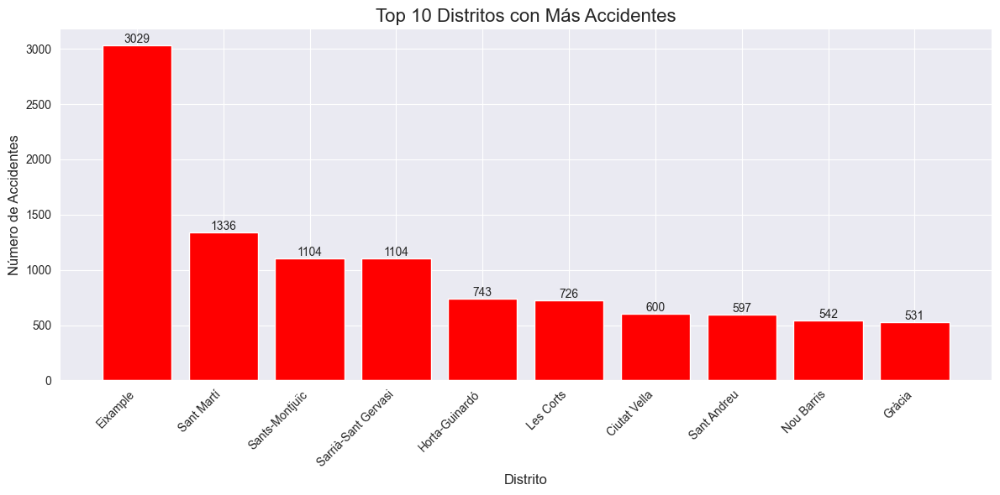

In [31]:
#Los 10 distritos con más accidentes
accidentes_por_distrito = df_accidentes['District Name'].value_counts().nlargest(10)

plt.figure(figsize=(12, 6))
bars = plt.bar(accidentes_por_distrito.index, accidentes_por_distrito.values, color='red')

plt.title('Top 10 Distritos con Más Accidentes', fontsize=16)
plt.xlabel('Distrito', fontsize=12)
plt.ylabel('Número de Accidentes', fontsize=12)
plt.xticks(rotation=45, ha='right')

# Añadir el número de accidentes sobre cada barra
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height,
             f'{height}',
             ha='center', va='bottom')

plt.tight_layout()
plt.show()

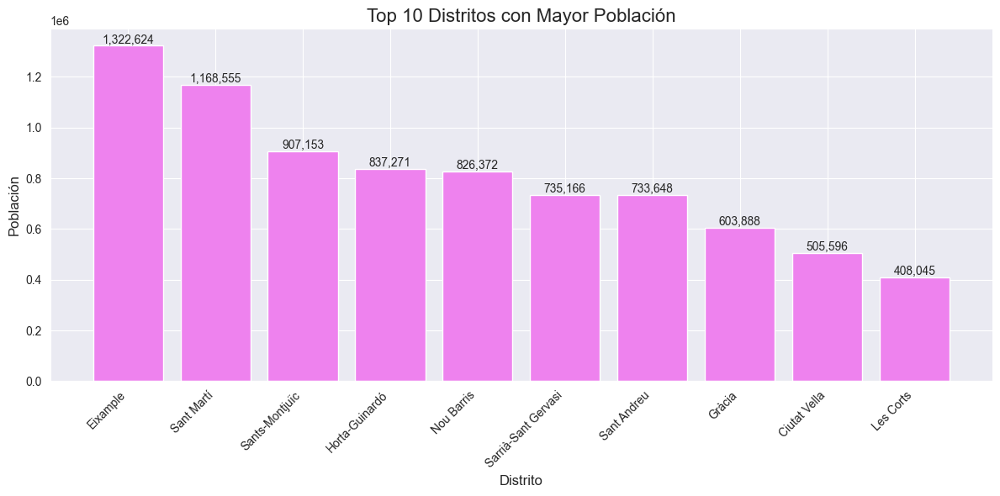

In [30]:
# Agrupar por distrito y sumar la población
poblacion_por_distrito = df_poblacion.groupby('District.Name')['Number'].sum().nlargest(10)

# Crear gráfico de barras
plt.figure(figsize=(12, 6))
bars = plt.bar(poblacion_por_distrito.index, poblacion_por_distrito.values, color='violet')

plt.title('Top 10 Distritos con Mayor Población', fontsize=16)
plt.xlabel('Distrito', fontsize=12)
plt.ylabel('Población', fontsize=12)
plt.xticks(rotation=45, ha='right')

# Añadir el número de población sobre cada barra
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height,
             f'{height:,}',  # Formato con comas para miles
             ha='center', va='bottom')

plt.tight_layout()
plt.show()

In [38]:
#Ver solo las columna de calidad del aire
df_calidad_aire['Air Quality'].value_counts()

Air Quality
Good        5453
Moderate     130
Name: count, dtype: int64

In [46]:
# Transformar la calidad del aire en valores numéricos
quality_map = {'Good': 3, 'Moderate': 2, 'Poor': 1, 'Very Poor': 0}
df_calidad_aire['Air Quality Numeric'] = df_calidad_aire['Air Quality'].map(quality_map)

# Crear el mapa base centrado en Barcelona
map_barcelona = folium.Map(location=[41.3851, 2.1734], zoom_start=12)

# Preparar los datos para el mapa de calor
heat_data = df_calidad_aire[['Latitude', 'Longitude', 'Air Quality Numeric']].values.tolist()

# Definir el gradiente de colores de verde a azul
color_gradient = {0: 'green', 0.5: 'lightblue', 1: 'blue'}

# Crear y añadir el mapa de calor
HeatMap(heat_data, 
        radius=30,
        min_opacity=0.7,
        max_zoom=1,
        gradient=color_gradient,
        name='Mapa de Calor de Calidad del Aire').add_to(map_barcelona)

# Añadir control de capas
folium.LayerControl().add_to(map_barcelona)

# Mostrar el mapa
display(map_barcelona)

# Guardar el mapa
map_barcelona.save("./exports/mapa_calor_pregunta4_calidad_aire.html")

### Conclusiones

Podemos observar que la cantidad de accidentes en Barcelona no es uniforme, existen distritos con mayor cantidad de accidentes que otros. En el mapa de calor podemos observar que los distritos del centro de la ciudad son los que tienen mayor cantidad de accidentes, mientras que los distritos perifericos tienen menos accidentes. Esto puede deberse a que los distritos del centro de la ciudad tienen mayor densidad de poblacion y, por lo tanto, mayor cantidad de vehiculos circulando, lo que aumenta la probabilidad de accidentes. Entendemos que los datos de calidad de aire aportan escasa informacion ya que solo se tienen 2 valores posibles, lo que no permite hacer un analisis detallado de la calidad del aire en los diferentes distritos de Barcelona, siendo ademas escasos puntos de toma. Sin embargo, los datos analizados muestran una buena calidad del aire, por lo que no se puede establecer una relacion entre la calidad del aire y la cantidad de accidentes.

#### ********************************************************************************************
### Pregunta 5: ¿Cómo varía la esperanza de vida en diferentes barrios de Barcelona?
#### ********************************************************************************************

In [48]:
df_expectativa_vida = pd.read_csv('../new_datasets/new_life_expectancy.csv')
df_expectativa_vida.head()

,Neighborhood,2006-2010,2007-2011,2008-2012,2009-2013,2010-2014,Gender,avg_life_expectancy
0,el Raval,87.5,84.9,84.7,84.9,85.3,Female,85.46
1,el Barri Gòtic,88.0,84.3,84.4,87.5,84.4,Female,85.72
2,la Barceloneta,88.2,85.3,84.4,86.3,84.7,Female,85.78
3,"Sant Pere, Santa Caterina i la Ribera",88.9,85.9,86.1,85.5,85.3,Female,86.34
4,el Fort Pienc,89.7,87.1,87.2,87.7,86.7,Female,87.68


In [49]:
df_expectativa_vida.columns

Index(['Neighborhood', '2006-2010', '2007-2011', '2008-2012', '2009-2013',
       '2010-2014', 'Gender', 'avg_life_expectancy'],
      dtype='object')

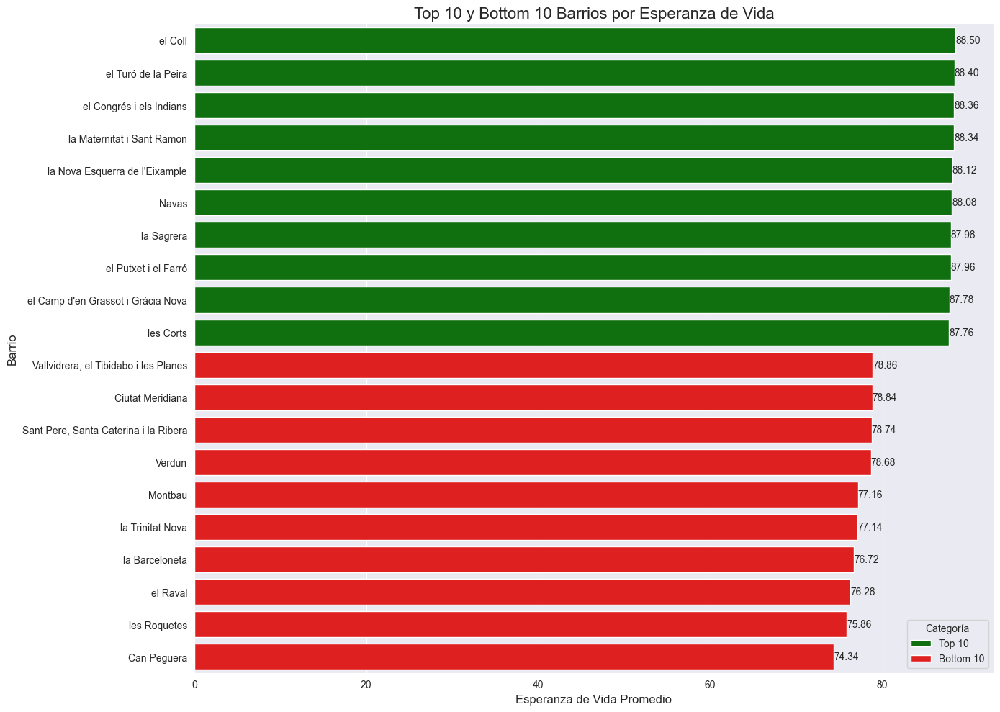

In [58]:
top_10 = df_expectativa_vida.nlargest(10, 'avg_life_expectancy')
bottom_10 = df_expectativa_vida.nsmallest(10, 'avg_life_expectancy').sort_values('avg_life_expectancy', ascending=False)

# Combinar los dataframes
combined = pd.concat([top_10, bottom_10])

# Crear una columna para identificar si es top o bottom
combined['category'] = ['Top 10' if i < 10 else 'Bottom 10' for i in range(20)]

plt.figure(figsize=(14, 10))
sns.barplot(x='avg_life_expectancy', y='Neighborhood', data=combined, 
            hue='category', dodge=False, palette={'Top 10': 'green', 'Bottom 10': 'red'})

plt.title('Top 10 y Bottom 10 Barrios por Esperanza de Vida', fontsize=16)
plt.xlabel('Esperanza de Vida Promedio', fontsize=12)
plt.ylabel('Barrio', fontsize=12)

# Añadir los valores al final de cada barra
for i, v in enumerate(combined['avg_life_expectancy']):
    plt.text(v, i, f'{v:.2f}', va='center', fontsize=10)

# Ajustar la leyenda
plt.legend(title='Categoría', loc='lower right', fontsize=10)

plt.tight_layout()
plt.show()

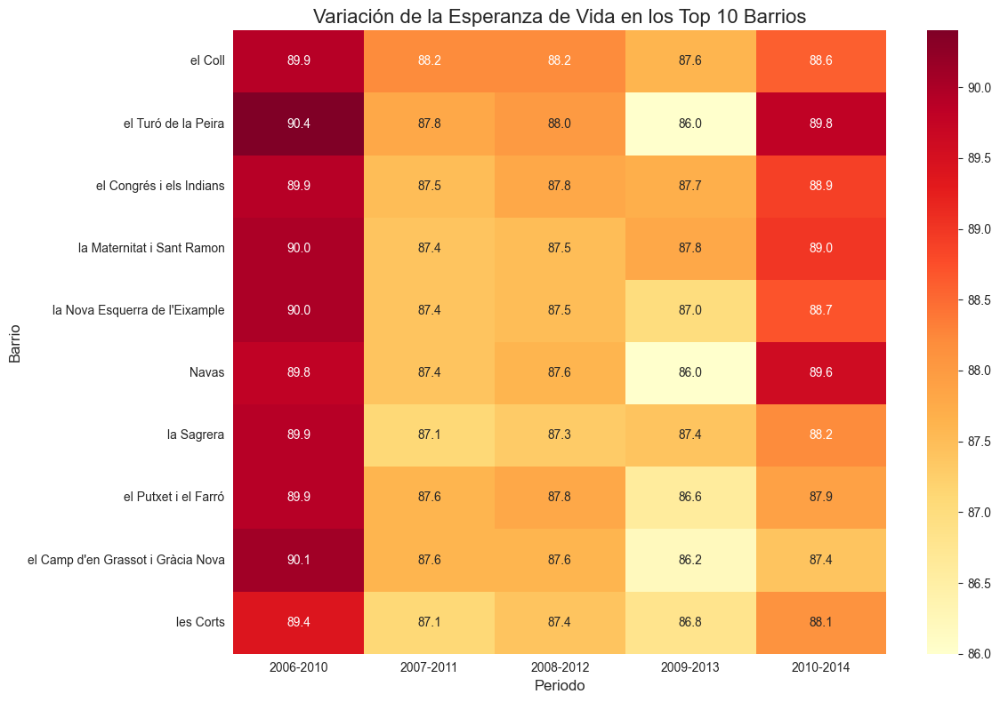

In [51]:
# Variación de la esperanza de vida en los top 10 barrios
periods = ['2006-2010', '2007-2011', '2008-2012', '2009-2013', '2010-2014']
top_10_heatmap = top_10[['Neighborhood'] + periods].set_index('Neighborhood')

plt.figure(figsize=(12, 8))
sns.heatmap(top_10_heatmap, annot=True, cmap='YlOrRd', fmt='.1f')
plt.title('Variación de la Esperanza de Vida en los Top 10 Barrios', fontsize=16)
plt.xlabel('Periodo', fontsize=12)
plt.ylabel('Barrio', fontsize=12)
plt.tight_layout()
plt.show()

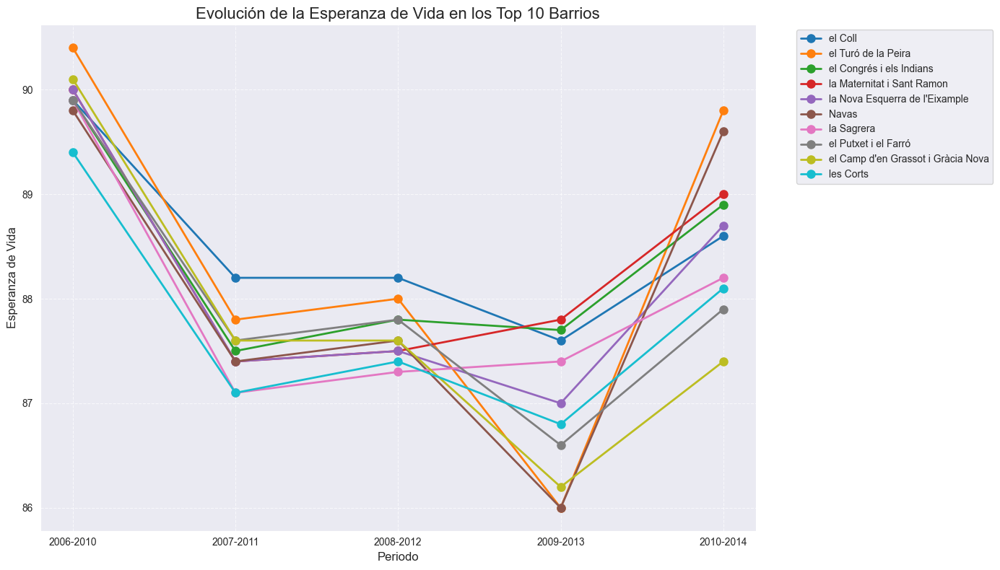

In [52]:
# Evolución de la esperanza de vida en los top 10 barrios
plt.figure(figsize=(14, 8))
for _, row in top_10.iterrows():
    plt.plot(periods, row[periods], marker='o', linewidth=2, markersize=8, 
             label=row['Neighborhood'])

plt.title('Evolución de la Esperanza de Vida en los Top 10 Barrios', fontsize=16)
plt.xlabel('Periodo', fontsize=12)
plt.ylabel('Esperanza de Vida', fontsize=12)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=10)
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

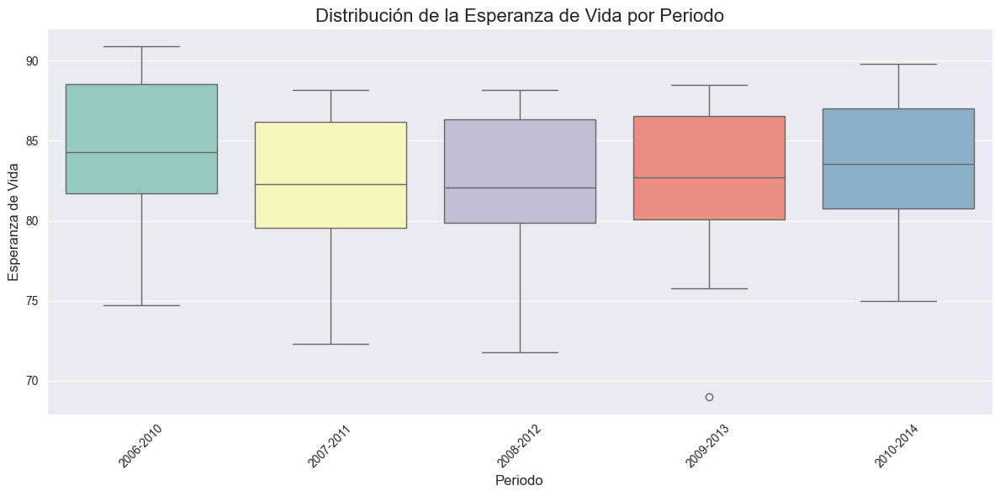

In [53]:
plt.figure(figsize=(12, 6))
sns.boxplot(data=df_expectativa_vida[periods], palette='Set3')
plt.title('Distribución de la Esperanza de Vida por Periodo', fontsize=16)
plt.xlabel('Periodo', fontsize=12)
plt.ylabel('Esperanza de Vida', fontsize=12)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

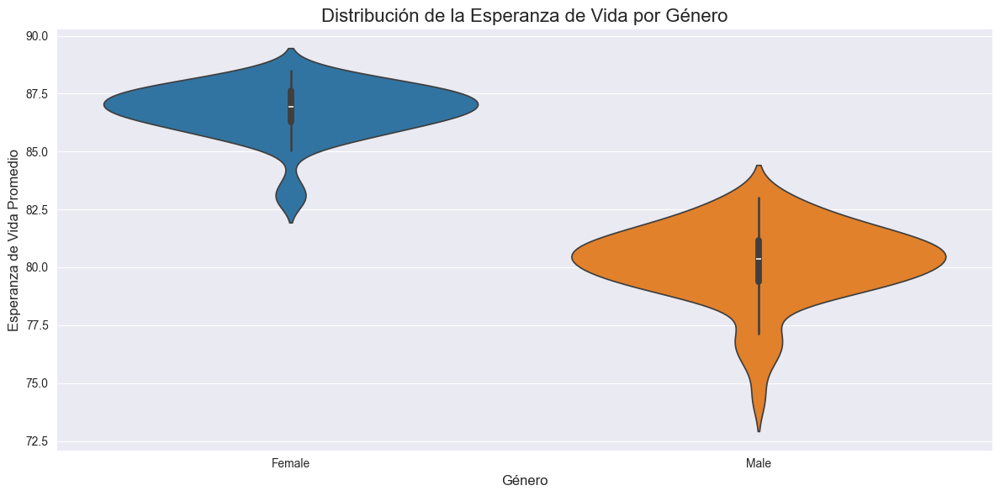

In [56]:
plt.figure(figsize=(12, 6))
sns.violinplot(x='Gender', y='avg_life_expectancy', data=df_expectativa_vida, 
               hue='Gender', dodge=False, legend=False)
plt.title('Distribución de la Esperanza de Vida por Género', fontsize=16)
plt.xlabel('Género', fontsize=12)
plt.ylabel('Esperanza de Vida Promedio', fontsize=12)
plt.tight_layout()
plt.show()

### Conclusiones

Podemos observar que la esperanza de vida en Barcelona no es uniforme, existen barrios con mayor esperanza de vida que otros. Existe una diferencia de 10 años entre la calidad de vida de los barrios, los cuales se corresponden a hogares de mayor ingresos, con mejor acceso a la salud y a todos los servicios. La esperanza de vida tampoco es uniforme, fluctúa seguramente respondiendo a los fenomenos que se daban en Barcelona en esos momentos, vemos un descenso en el periodo 2009-2013. Sin embargo si distribuimos los datos en los periodos vemos una cierta estabilidad en el promedio de expectativa de vida en los años contemplados en los datos. Por otro lado, la esperanza de vida varía entre géneros, las mujeres tienden a tener una esperanza de vida  mayor que los hombres.

#### ********************************************************************************************
### Pregunta 6: ¿Cuál es la relación entre la cantidad de inmigrantes y los niveles de desempleo en los diferentes barrios?
#### ********************************************************************************************

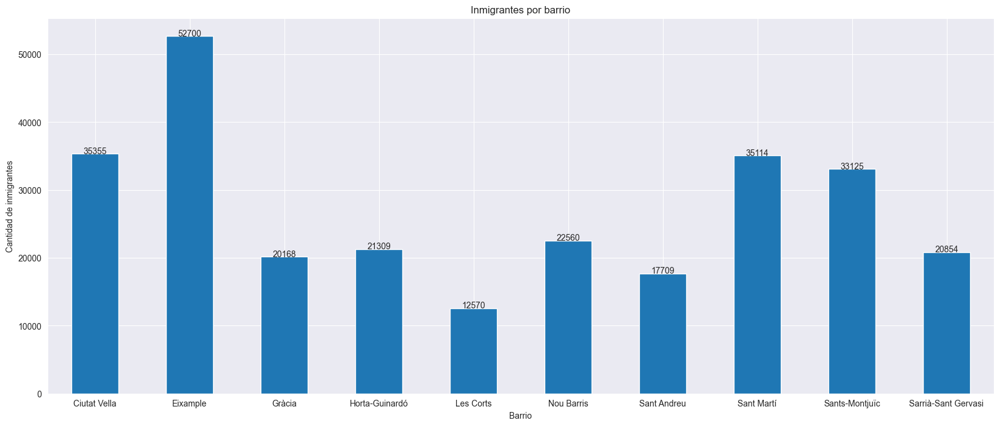

In [59]:
#Cantidad de inmigrantes por barrio
df_immigrants_age = pd.read_csv('../new_datasets/new_immigrants_age.csv')
#Eliminar la fila con el distrito "No consta"
df_immigrants_age = df_immigrants_age[df_immigrants_age['District Name'] != 'No consta']

df_immigrants_age.groupby('District Name')['Immigrants'].sum().plot(kind='bar', figsize=(20,8), rot=0)

plt.title('Inmigrantes por barrio')
plt.xlabel('Barrio')
plt.ylabel('Cantidad de inmigrantes')

# Agregarle el valor a cada barra
for index, value in enumerate(df_immigrants_age.groupby('District Name')['Immigrants'].sum()):
    plt.text(index, value, str(value), ha='center')

# plotear
plt.show()

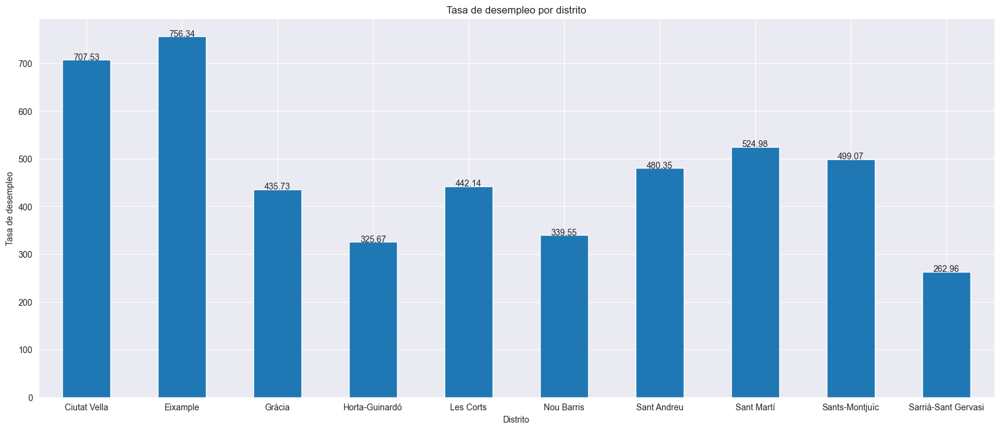

In [60]:
#Desempleo por barrio
df_unemployment = pd.read_csv('../new_datasets/new_unemployment.csv')

# Graficar la tasa de desempleo por barrio
df_unemployment = df_unemployment[df_unemployment['District Name'] != 'No consta']

df_unemployment.groupby(['District Name'])['Number'].mean().plot(kind='bar', figsize=(20,8), rot=0)

plt.title('Tasa de desempleo por distrito')
plt.xlabel('Distrito')
plt.ylabel('Tasa de desempleo')

# Agregarle el valor a cada barra
for index, value in enumerate(df_unemployment.groupby(['District Name'])['Number'].mean()):
    plt.text(index, value, f'{value:.2f}', ha='center')
    
# plotear
plt.show()

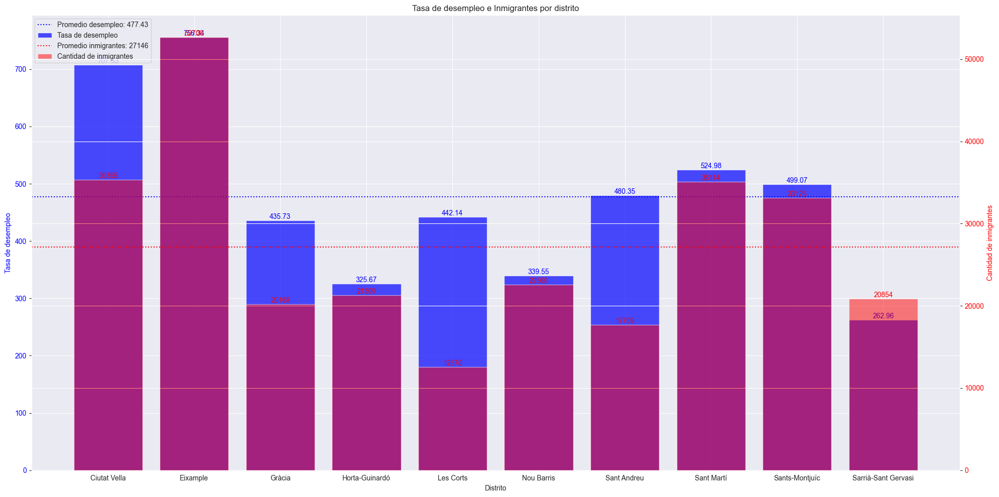

In [62]:
# Filtrar los datos
df_unemployment = df_unemployment[df_unemployment['District Name'] != 'No consta']
df_immigrants_age = df_immigrants_age[df_immigrants_age['District Name'] != 'No consta']

# Preparar los datos
unemployment_data = df_unemployment.groupby(['District Name'])['Number'].mean()
immigrants_data = df_immigrants_age.groupby('District Name')['Immigrants'].sum()

# Calcular promedios
unemployment_avg = unemployment_data.mean()
immigrants_avg = immigrants_data.mean()

# Crear la figura y los ejes
fig, ax1 = plt.subplots(figsize=(20,10))

# Graficar la tasa de desempleo
bars1 = ax1.bar(unemployment_data.index, unemployment_data.values, color='blue', alpha=0.7, label='Tasa de desempleo')
ax1.set_xlabel('Distrito')
ax1.set_ylabel('Tasa de desempleo', color='blue')
ax1.tick_params(axis='y', labelcolor='blue')

# Agregar línea de promedio para desempleo
ax1.axhline(y=unemployment_avg, color='blue', linestyle=':', label=f'Promedio desempleo: {unemployment_avg:.2f}')

# Crear un segundo eje y
ax2 = ax1.twinx()

# Graficar la cantidad de inmigrantes
bars2 = ax2.bar(immigrants_data.index, immigrants_data.values, color='red', alpha=0.5, label='Cantidad de inmigrantes')
ax2.set_ylabel('Cantidad de inmigrantes', color='red')
ax2.tick_params(axis='y', labelcolor='red')

# Agregar línea de promedio para inmigrantes
ax2.axhline(y=immigrants_avg, color='red', linestyle=':', label=f'Promedio inmigrantes: {immigrants_avg:.0f}')

# Ajustar las etiquetas del eje x
plt.xticks(rotation=45, ha='right')

# Agregar título
plt.title('Tasa de desempleo e Inmigrantes por distrito')

# Agregar leyenda
lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines1 + lines2, labels1 + labels2, loc='upper left')

# Ajustar el diseño
plt.tight_layout()

# Agregar valores a las barras
for i, v in enumerate(unemployment_data):
    ax1.text(i, v, f'{v:.2f}', ha='center', va='bottom', color='blue')

for i, v in enumerate(immigrants_data):
    ax2.text(i, v, str(int(v)), ha='center', va='bottom', color='red')

# Mostrar el gráfico
plt.show()

### Conclusiones

Podemos observar que la inmigracion a los distintos barrios de Barcelona no es uniforme, existen barrios con mayor cantidad de inmigrantes que otros. Por otro lado, la tasa de desempleo en los barrios de Barcelona tampoco es uniforme, sin embargo el promedio se mantiene mas estable respecto a los valores en cada barrio. Los valores de desempleo de los barrios con mayor cantidad de inmigrantes son mas altos, sobre todo en Eixample, sto puede deberse a que los inmigrantes tienen mayor dificultad para encontrar empleo, lo que se refleja en las tasas de desempleo de los barrios con mayor cantidad de inmigrantes suba. Se dan dos casos borde, donde la tasa de desempleo es muy alta y la cantidad de inmigrantes es muy baja, lo que puede deberse a que son barrios con poca poblacion y poca oferta laboral; y el otro caso de mayor cantidad de inmigrantes que tasa de desempleo, lo que puede deberse a que son barrios con mayor oferta laboral.

#### ********************************************************************************************
### Pregunta 7: ¿Cuales son los nombres mas populares en Barcelona?, ¿influye la inmigración?
#### ********************************************************************************************

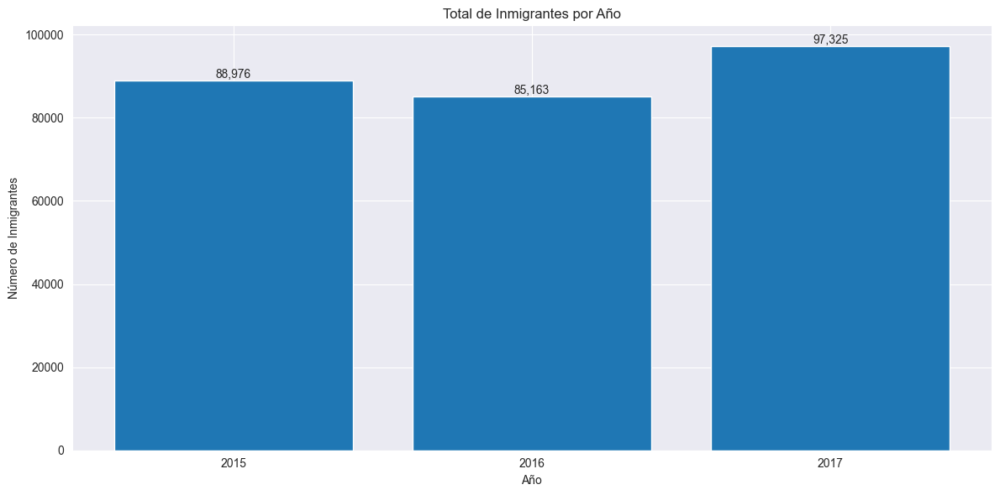

In [68]:
df_inmigrantes = pd.read_csv("../new_datasets/new_immigrants_age.csv")

# Agrupar por año y sumar inmigrantes
immigrants_by_year = df_inmigrantes.groupby('Year')['Immigrants'].sum().reset_index()

# Crear el gráfico
plt.figure(figsize=(12, 6))
bars = plt.bar(immigrants_by_year['Year'], immigrants_by_year['Immigrants'])

# Personalizar el gráfico
plt.title('Total de Inmigrantes por Año')
plt.xlabel('Año')
plt.ylabel('Número de Inmigrantes')

# Configurar el eje X para mostrar solo años enteros
years = immigrants_by_year['Year'].unique()
plt.xticks(np.arange(min(years), max(years)+1, 1.0))

# Mostrar valores en las barras
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height,
             f'{int(height):,}',
             ha='center', va='bottom')

# Mostrar el gráfico
plt.tight_layout()
plt.show()

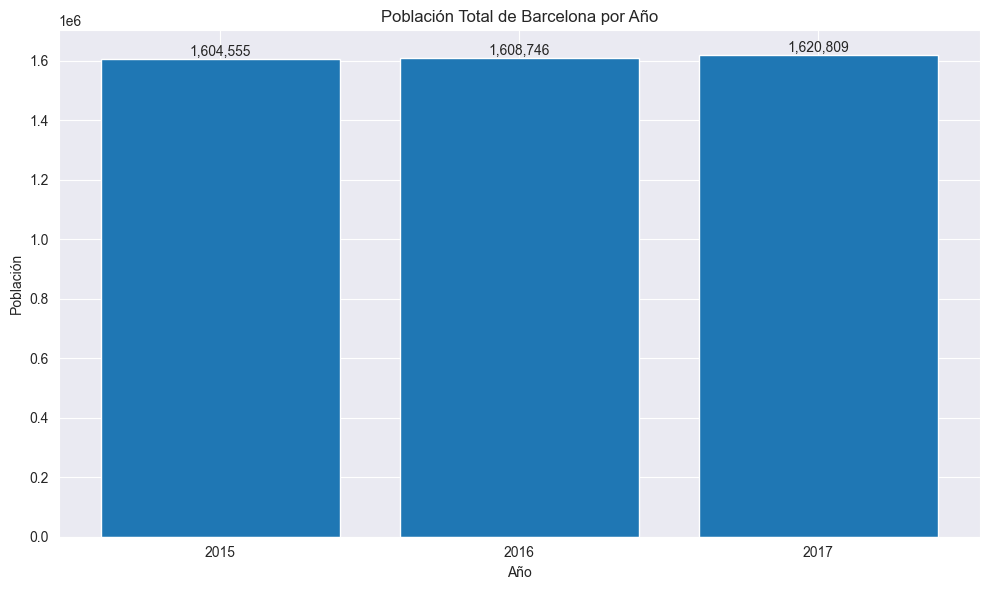

In [69]:
df_poblacion = pd.read_csv('../new_datasets/new_population.csv')

# Filtrar los años que nos interesan
years_of_interest = [2015, 2016, 2017]
df_filtered = df_poblacion[df_poblacion['Year'].isin(years_of_interest)]

# Agrupar por año y sumar la población
population_by_year = df_filtered.groupby('Year')['Number'].sum().reset_index()

# Crear la gráfica de barras
plt.figure(figsize=(10, 6))
bars = plt.bar(population_by_year['Year'], population_by_year['Number'])

# Personalizar la gráfica
plt.title('Población Total de Barcelona por Año')
plt.xlabel('Año')
plt.ylabel('Población')
plt.xticks(years_of_interest)

# Añadir etiquetas con los valores sobre las barras
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height,
             f'{int(height):,}',
             ha='center', va='bottom')

# Ajustar los márgenes
plt.tight_layout()

# Mostrar la gráfica
plt.show()

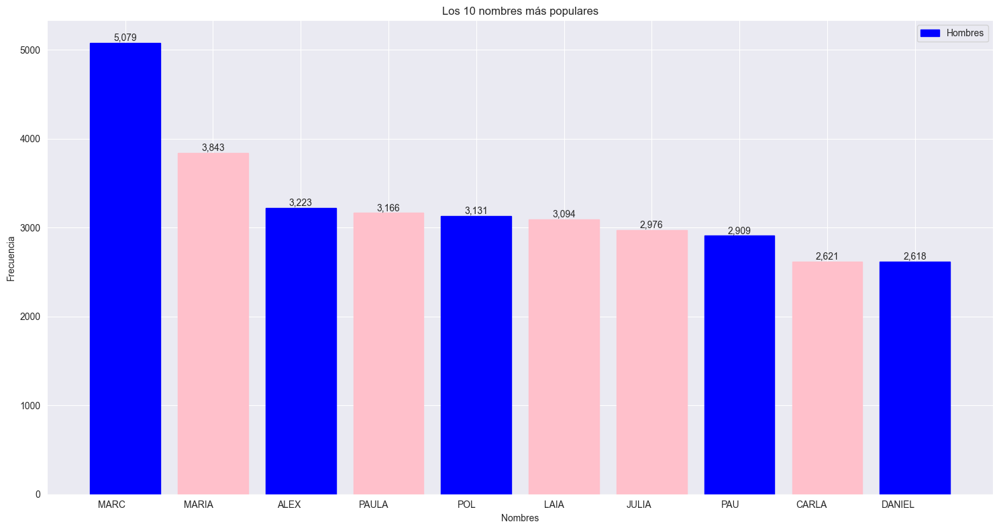

In [71]:
# Obtener los 10 nombres más populares en general
df_nombres_bebes = pd.read_csv('../new_datasets/new_baby_names.csv')

top_names = df_nombres_bebes.groupby('Name')['Frequency'].sum().nlargest(10).reset_index()

# Obtener el género más común para cada nombre
top_names['Gender'] = top_names['Name'].map(df_nombres_bebes.groupby('Name')['Gender'].first())

# Ordenar por frecuencia
top_names = top_names.sort_values('Frequency', ascending=False)

# Crear el gráfico
plt.figure(figsize=(15, 8))
bars = plt.bar(range(10), top_names['Frequency'])

# Personalizar el gráfico
plt.title('Los 10 nombres más populares')
plt.xlabel('Nombres')
plt.ylabel('Frecuencia')
plt.xticks(range(10), top_names['Name'], rotation=0, ha='right')

# Colorear las barras y añadir etiquetas con valores
for i, (_, row) in enumerate(top_names.iterrows()):
    bars[i].set_color('blue' if row['Gender'] == 'Male' else 'pink')
    plt.text(i, row['Frequency'], f'{row["Frequency"]:,}', 
             ha='center', va='bottom')

# Añadir una leyenda
plt.legend(['Hombres', 'Mujeres'])

# Ajustar el diseño
plt.tight_layout()

# Mostrar el gráfico
plt.show()

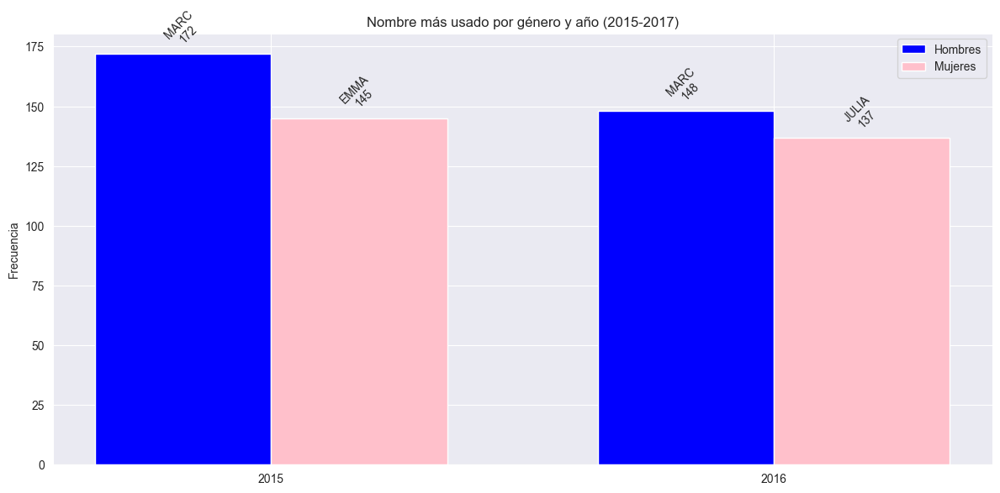

In [72]:
# Filtrar solo los años 2015, 2016 y 2017
years_of_interest = [2015, 2016, 2017]

df_baby_names = df_nombres_bebes[df_nombres_bebes['Year'].isin(years_of_interest)]

# Encontrar el nombre más usado por género y año
top_names = df_baby_names.groupby(['Year', 'Gender'])['Frequency'].max().reset_index()
top_names = top_names.merge(df_baby_names, on=['Year', 'Gender', 'Frequency'])

# Ordenar por año
top_names = top_names.sort_values('Year')

# Obtener años únicos y calcular posiciones de las barras
years = top_names['Year'].unique()
x = range(len(years))
width = 0.35

# Crear el gráfico
fig, ax = plt.subplots(figsize=(12, 6))

# Graficar barras para hombres y mujeres
male_data = top_names[top_names['Gender'] == 'Male']
female_data = top_names[top_names['Gender'] == 'Female']

rects1 = ax.bar(x, male_data['Frequency'], width, label='Hombres', color='blue')
rects2 = ax.bar([i + width for i in x], female_data['Frequency'], width, label='Mujeres', color='pink')

# Personalizar el gráfico
ax.set_ylabel('Frecuencia')
ax.set_title('Nombre más usado por género y año (2015-2017)')
ax.set_xticks([i + width/2 for i in x])
ax.set_xticklabels(years, rotation=0)
ax.legend()

# Función para agregar etiquetas en las barras
def autolabel(rects, names):
    for rect, name in zip(rects, names):
        height = rect.get_height()
        ax.annotate(f'{name}\n{height:,}',
                    xy=(rect.get_x() + rect.get_width() / 2, height),
                    xytext=(0, 3),  # 3 puntos de desplazamiento vertical
                    textcoords="offset points",
                    ha='center', va='bottom', rotation=45)

# Agregar etiquetas a las barras
autolabel(rects1, male_data['Name'])
autolabel(rects2, female_data['Name'])

# Ajustar el diseño
fig.tight_layout()

# Mostrar el gráfico
plt.show()

### Conclusiones

Podemos observar como los nombres mas comunes de Barcelona son escencialmente Catalanes, es decir, mantienen la tradicion del lugar y no se ve influienciado por la inmigracion. Vemos como comparado con la poblacion de Barcelona, el porcentaje de inmigrantes es muy reducido. Por otro lado, vemos como los nombres mas comunes no varian mucho a lo largo de los años, lo que nos indica que la tradicion en los nombres se mantiene a lo largo del tiempo.

#### ********************************************************************************************
### Pregunta 8: ¿Cual es la relación entre las muertes, el desempleo y la inmigración en diferentes barrios de Barcelona?

#### ********************************************************************************************

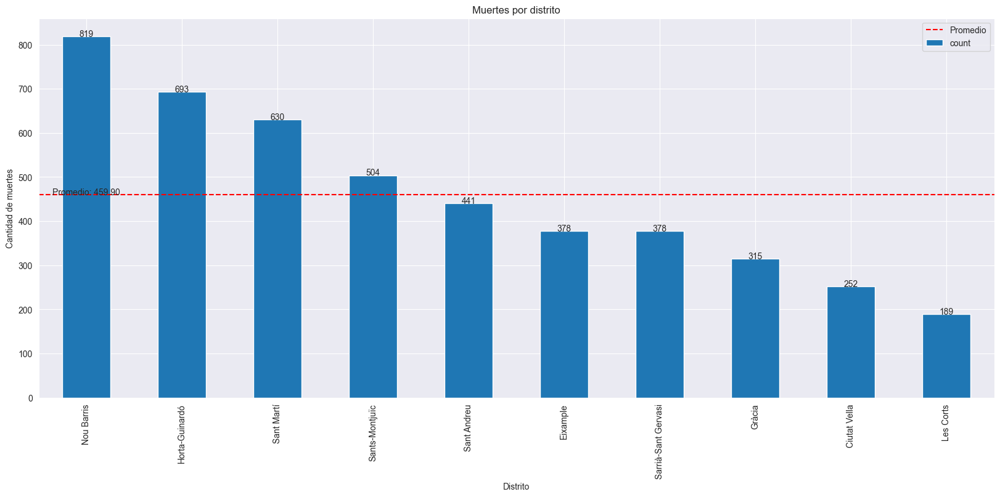

In [73]:
df_muertes = pd.read_csv('../new_datasets/new_deaths.csv')

# Graficar la cantidad de muertes por distrito
df_muertes['District.Name'].value_counts().plot(kind='bar', figsize=(20,8))

plt.title('Muertes por distrito')
plt.xlabel('Distrito')
plt.ylabel('Cantidad de muertes')

# Agregarle el valor a cada barra
for index, value in enumerate(df_muertes['District.Name'].value_counts()):
    plt.text(index, value, str(value), ha='center')
    
# Linea de promedio
plt.axhline(y=df_muertes['District.Name'].value_counts().mean(), color='r', linestyle='--', label='Promedio')

plt.text(0, df_muertes['District.Name'].value_counts().mean(), 'Promedio: {:.2f}'.format(df_muertes['District.Name'].value_counts().mean()), ha='center')

plt.legend()    
# plotear
plt.show()

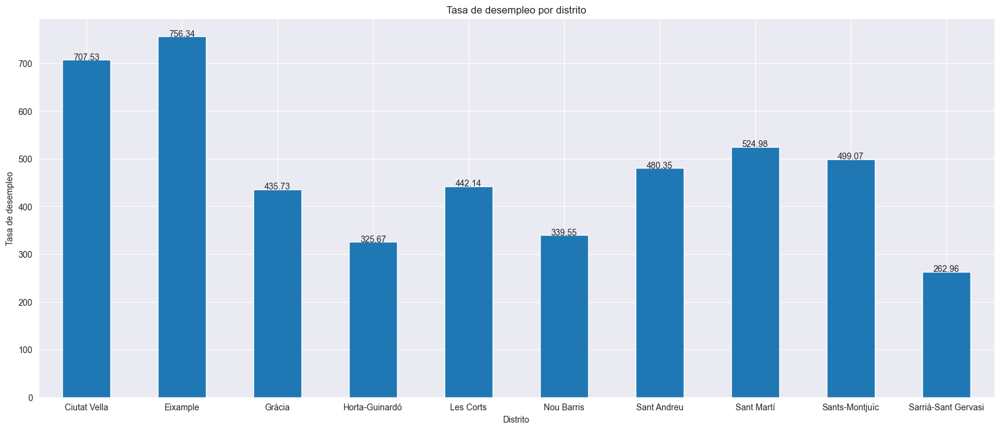

In [74]:
# Graficar la tasa de desempleo por distrito
df_unemployment = df_unemployment[df_unemployment['District Name'] != 'No consta']

df_unemployment.groupby(['District Name'])['Number'].mean().plot(kind='bar', figsize=(20,8), rot=0)

plt.title('Tasa de desempleo por distrito')
plt.xlabel('Distrito')
plt.ylabel('Tasa de desempleo')

# Agregarle el valor a cada barra
for index, value in enumerate(df_unemployment.groupby(['District Name'])['Number'].mean()):
    plt.text(index, value, f'{value:.2f}', ha='center')
    
# plotear
plt.show()

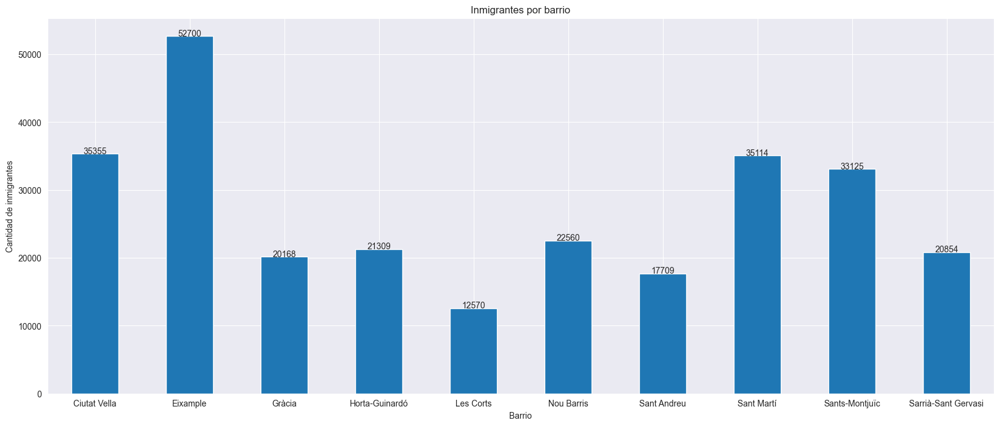

In [75]:
df_inmigrantes = pd.read_csv("../new_datasets/new_immigrants_age.csv")

#Cantidad de inmigrantes por barrio
df_immigrants_age = pd.read_csv('../new_datasets/new_immigrants_age.csv')
#Eliminar la fila con el distrito "No consta"
df_immigrants_age = df_immigrants_age[df_immigrants_age['District Name'] != 'No consta']

df_immigrants_age.groupby('District Name')['Immigrants'].sum().plot(kind='bar', figsize=(20,8), rot=0)

plt.title('Inmigrantes por barrio')
plt.xlabel('Barrio')
plt.ylabel('Cantidad de inmigrantes')

# Agregarle el valor a cada barra
for index, value in enumerate(df_immigrants_age.groupby('District Name')['Immigrants'].sum()):
    plt.text(index, value, str(value), ha='center')

# plotear
plt.show()

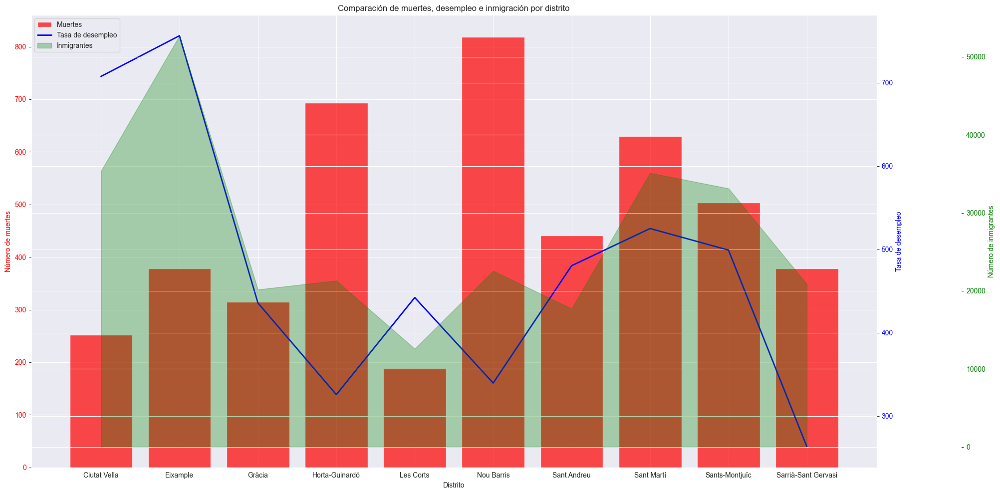

In [77]:
# Preparar los datos
muertes_por_distrito = df_muertes['District.Name'].value_counts().sort_index()
desempleo_por_distrito = df_unemployment[df_unemployment['District Name'] != 'No consta'].groupby('District Name')['Number'].mean().sort_index()
inmigrantes_por_distrito = df_inmigrantes[df_inmigrantes['District Name'] != 'No consta'].groupby('District Name')['Immigrants'].sum().sort_index()

# Crear el gráfico con múltiples ejes
fig, ax1 = plt.subplots(figsize=(20, 10))

# Gráfico de barras para muertes (eje izquierdo)
ax1.bar(muertes_por_distrito.index, muertes_por_distrito.values, alpha=0.7, color='red', label='Muertes')
ax1.set_xlabel('Distrito')
ax1.set_ylabel('Número de muertes', color='red')
ax1.tick_params(axis='y', labelcolor='red')

# Crear un segundo eje para el desempleo
ax2 = ax1.twinx()
ax2.plot(desempleo_por_distrito.index, desempleo_por_distrito.values, color='blue', linewidth=2, label='Tasa de desempleo')
ax2.set_ylabel('Tasa de desempleo', color='blue')
ax2.tick_params(axis='y', labelcolor='blue')

# Crear un tercer eje para los inmigrantes
ax3 = ax1.twinx()
ax3.spines['right'].set_position(('axes', 1.1))  # Mover el eje a la derecha
ax3.fill_between(inmigrantes_por_distrito.index, inmigrantes_por_distrito.values, alpha=0.3, color='green', label='Inmigrantes')
ax3.set_ylabel('Número de inmigrantes', color='green')
ax3.tick_params(axis='y', labelcolor='green')

# Configurar el gráfico
plt.title('Comparación de muertes, desempleo e inmigración por distrito')
plt.xticks(rotation=45, ha='right')

# Combinar las leyendas
lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
lines3, labels3 = ax3.get_legend_handles_labels()
ax3.legend(lines1 + lines2 + lines3, labels1 + labels2 + labels3, loc='upper left')

# Ajustar el diseño
plt.tight_layout()

# Mostrar el gráfico
plt.show()

### Conclusiones

En primer lugar, se observa una variación significativa entre los distritos en cuanto a estos tres indicadores. Nou Barris destaca por tener el mayor número de muertes, mientras que distritos como Ciutat Vella y Eixample presentan números más bajos en este aspecto. Sin embargo, Ciutat Vella y Eixample muestran los niveles más altos de inmigración, lo que sugiere que estas áreas son puntos focales para los recién llegados a la ciudad. En cuanto al desempleo, la tasa parece fluctuar considerablemente entre distritos, con picos notables en áreas como Sant Andreu y Sant Martí. Pareceria que podemos observar una cierta relacion entre los inmigrantes y el desempleo en la gran mayoria de los distritos.

Es importante notar que no parece haber una correlación directa y consistente entre los tres indicadores en todos los distritos. Por ejemplo, mientras que Nou Barris tiene el mayor número de muertes, no necesariamente presenta los niveles más altos de inmigración o desempleo. Esto sugiere que cada distrito enfrenta sus propios desafíos únicos